## PCA on Handwritten Digits

PCA is a dimensionality reduction techinique, i.e. it doesn't use the outputs. <br>
<b>Goal: Projection of input vector X to a reduced input vector Y usiing a projection matrix: P. </b><br>
The construction of the projection matrix is based on a maximization problem: maximizing the variance explained by each principal component.

In [1]:
# Basic Numeral Libraries
import numpy as np
import pandas as pd

# Standard Data Analysis Library and Tools
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Plotting Libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Utility Functions
import os, re
from pprint import pprint
import random

# SkLearn Modules and Models
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

### Loading MNIST Dataset

In [2]:
# Dataset Files Locations
train_dataset_loc = './MNIST Dataset/mnist_train.csv'
test_dataset_loc = './MNIST Dataset/mnist_test.csv'

train_df = pd.read_csv(train_dataset_loc)
test_df = pd.read_csv(test_dataset_loc)

#### Combining both MNIST train.csv and test.csv into Train Dataset

In [3]:
# Combining both Train & Test MNIST CSV Dataset 
train_dataset = pd.concat([train_df, test_df], axis = 0, ignore_index = True)
train_dataset.tail(2)

,label,1x1,1x2,1x3,1x4,1x5,1x6,1x7,1x8,1x9,...,28x19,28x20,28x21,28x22,28x23,28x24,28x25,28x26,28x27,28x28
69998,5,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
69999,6,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


#### Separating Label and Pixel Features

In [4]:
X_train_input, y_train_target = train_dataset.iloc[:, 1:], train_dataset.iloc[:, 0]
print(f"X_INPUT Shape: {X_train_input.shape}")
print(f"y_TARGET Shape: {y_train_target.shape}")

X_INPUT Shape: (70000, 784)
y_TARGET Shape: (70000,)


#### Dataset Sample Visualization

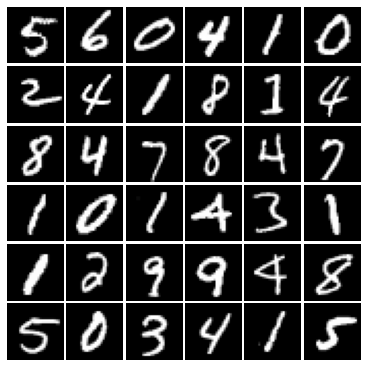

In [5]:
plt.figure(figsize = (5, 5))
plt.subplots_adjust(left=0.01, right=0.99, bottom=0.01, top=0.99, wspace=0.05, hspace=0.05)
for i in range(36):
    plt.subplot(6, 6, i + 1)
    rand_index = random.randint(0, len(X_train_input))
    rand_img = X_train_input.iloc[rand_index].to_numpy().reshape(28, 28)
    plt.imshow(rand_img, cmap = 'gray')
    plt.axis('off')
plt.show()   

### Normalizing Pixels Featurs (X_train_input)
NOTE: While using StandardScaler(), if you have separate training and test datasets, it's important to fit the scaler only on the training data and then use the same scaler to transform the test data. This ensures that the scaling is consistent across both datasets.

#### Using StandardScaler() function

In [6]:
scaler_X = StandardScaler()
scaled_X_train_1 = scaler_X.fit_transform(X_train_input)

#### Using Manual functions

In [7]:
mean = np.mean(X_train_input, axis = 0)
std = np.std(X_train_input, axis = 0)
scaled_X_train_2 = ((X_train_input - mean) / std).values
scaled_X_train_2 = np.nan_to_num(scaled_X_train_2, nan = 0)

In [8]:
np.sum((scaled_X_train_1 - scaled_X_train_2) ** 2)

1.1046327118531345e-17

In [9]:
scaled_X_train = scaled_X_train_1

Since, the squared distance between two scaled_X_train from StandardScaler() and Manual method is nearly equal to zero. So, I conclude that both method yields same operation output.

#### PCA: 
- Find Covariance Matrix of the Input Data
- Plot and Analyze the Covariance Matrix
- Goal: The covariance matrix should have principal diagonal elements maximum and non-diagonal elements nearly zero

#### Comparing Covariance Calculation between np.cov() and Manual method <br>

In [10]:
# Using np.cov() function from Numpy
X_cov = np.cov((X_train_input-mean).T)

In [11]:
manual_X_cov = ((X_train_input - mean).T @ (X_train_input)) / (X_train_input.shape[0] - 1)

In [12]:
np.sum(np.sum((X_cov - manual_X_cov) ** 2))

5.940840799088482e-19

Again, on comparing manual Covariance Matrix and np.cov() method, both gave results whose distance seems little to zero. <br>
NOTE: <b> But, the covariance is actually taken for (X_train_input - mean) / std i.e. output from StandardScaler() or onscaled_X_train </b>

In [13]:
X_cov = np.cov(scaled_X_train.T, dtype = np.float64)

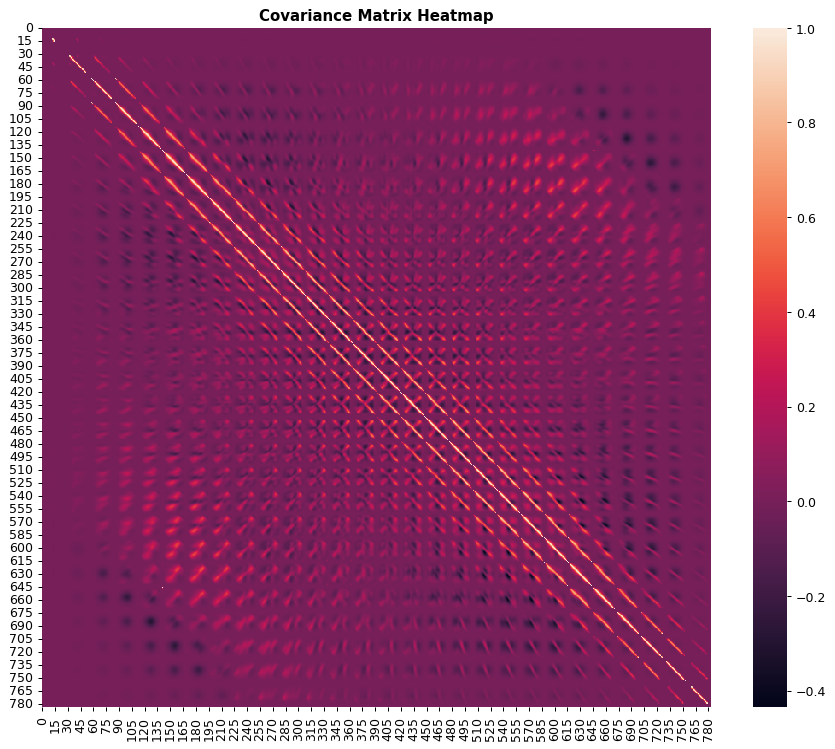

In [14]:
plt.figure(figsize=(12, 10), dpi = 90)
sns.heatmap(pd.DataFrame(X_cov), annot = False)
plt.tick_params(axis='both', which='both', labelsize=10)
plt.title("Covariance Matrix Heatmap", fontdict = {'size':12, 'weight':'bold'})
plt.show()

#### Analysis: (UJJWAL MAKE AMENDS)
1. The higher values along the principal diagonal shows that the given input data has larger variance in a particular direction and perpendicular to it, the variance is low.
2. The objective is to find a matrix Y such that the transformation of input data X, will give a covariance on Y such that the elements on the principal diagonal is maximum and elsewhere nearly zero.
3. This might mean that the given MNIST data has some pattern, which could be leveraged to get the prominent features and suppress the noises or in simple terms, PCA can be applied to this to get better data representation.

### Eigenvectors and Eigenvalues of Covariance Matrix

In [17]:
#Note: Eigenvalues aren't necessarily sorted, but eigenvalues[i] 'DOES' correspond to eigenvectors.T[i]
eigenvalues_1, eigenvectors = np.linalg.eig(X_cov) 

print(f"Eigenvalues Shape: {eigenvalues.shape}")
print(f"Eigenvectors Shape: {eigenvectors.shape}")

Eigenvalues Shape: (784,)
Eigenvectors Shape: (784, 784)


In [23]:
from scipy.linalg import eigh

eigenvalues, eigenvectors = eigh(X_cov)

In [24]:
from sklearn.metrics.pairwise import cosine_similarity

cosine_similarity(eigenvalues_1.reshape(1, -1), eigenvalues.reshape(1, -1))

array([[0.00430911]])

On assessing different functions for calculating eigenvalues, we found that the np.linalg.eig(X_cov) given negavtive eigenvalues with clipping effect for less than 1e-17. So, scipy.linalg.eigh(X_cov) is used whose value is similar to 'explained_variance_' from sklearn PCA, but still this shows some clipping effect, which has been down.<br>
Also, the cosine similarity between the eigenvalues from np.linalg.eigh() and scipy.linalg.eigh() shows that they are highly dissimilar, but at the same time the similarity score between eigenvalues from np.linalg.eigh() and from sklearn_PCA.explained_variance_ is 1.0 (High).

NOTE: The Eigenvectors are column-wise expressed from above np.linalg.eig(X_cov).

#### Unhealthy implementation of sorting eigenvalues and eigenvectors. 

In [25]:
# Unsorted tuple of (eigenvalues[i], eigenvectors[i])
unsorted_eigen_value_vector = [(np.abs(eigenvalues[i]), eigenvectors[:, i]) for i in range(len(eigenvalues))]

# Sorting tuple by eigenvalues
eigen_values_vectors = sorted(unsorted_eigen_value_vector, reverse = True, key = lambda x : x[0])

#### Smart way to sort eigenvalues and eigenvectors.
In this implemention, the eigenvectors are transposed i.e. row-wise eigenvector representation.

In [26]:
sorted_idxs = np.argsort(np.abs(eigenvalues))[::-1]
eigenvalues = np.abs(eigenvalues)[sorted_idxs]
eigenvectors = eigenvectors.T[sorted_idxs] # The transposed act

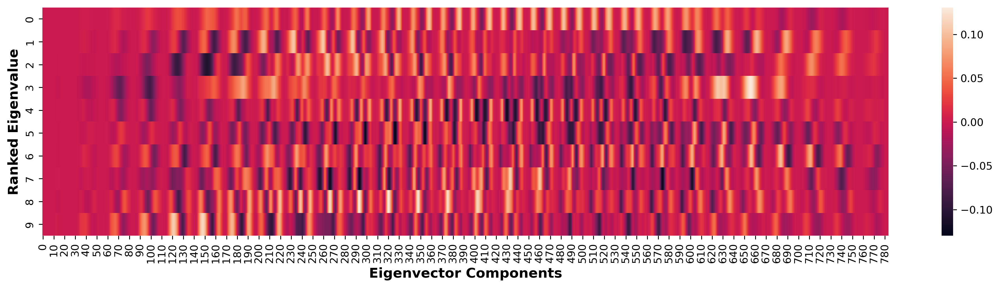

In [27]:
fig = plt.figure(figsize=(18,4), dpi = 270)
sns.heatmap(pd.DataFrame(eigenvectors[:10]), annot=False)
plt.ylabel("Ranked Eigenvalue", fontdict = {'size':13, 'weight':'bold'})
plt.xlabel("Eigenvector Components", fontdict = {'size':13, 'weight':'bold'})
plt.show()

#### Analysis: (UJJWAL MAKE AMENDS)
1. This heatmap visualization of Eigenvector Components for Top 10 Ranked Eigenvalue basically identify which eigenvector components dominate in each eigenvalue. 
2. This is essentially a visualization of what information the principal component analysis has judged most important. 
3. The spots of high and low values indicate there may be a few values where the presence of a pixel is a strong indicator that a number is or is not a certain digit.

### Proportion of Variance
To measure the 'principalness' of each principal component, we can determine how much of the variance in the data it can explain.

In [28]:
lam_sum = sum(eigenvalues)
explained_variance = [(lam_k / lam_sum) for lam_k in sorted(eigenvalues, reverse = True)]

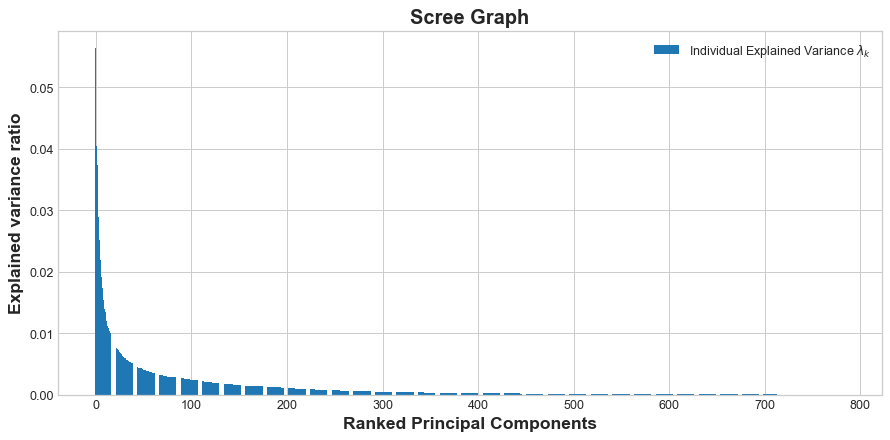

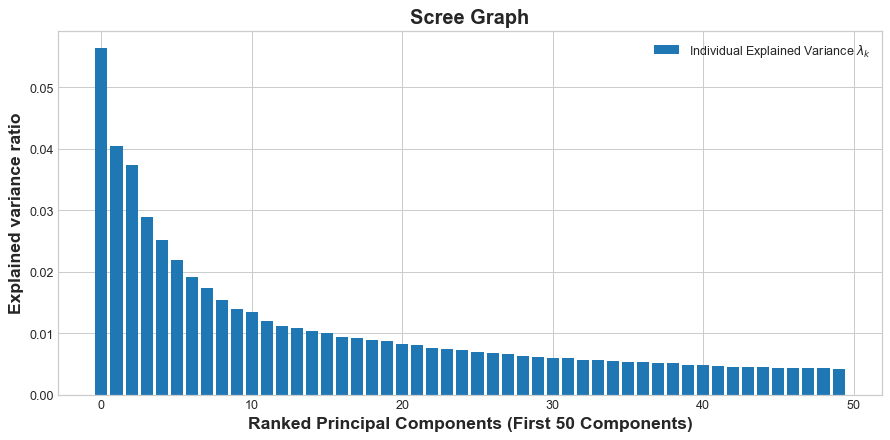

In [29]:
plt.figure(figsize=(10, 5), dpi = 90)
plt.style.use('seaborn-whitegrid')
font_title = {'size': 16, 'weight': 'bold'}
font_label = {'size': 14, 'weight': 'bold'}

plt.bar(range(len(explained_variance)), explained_variance,
        label='Individual Explained Variance $\lambda_{k}$', align = 'center', linewidth = .5)

plt.title("Scree Graph", fontdict = font_title)

plt.ylabel('Explained variance ratio', fontdict = font_label)
plt.xlabel('Ranked Principal Components', fontdict = font_label)

plt.legend(loc = 'best')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 5), dpi = 90)
plt.bar(range(len(explained_variance))[:50], explained_variance[:50],
        label='Individual Explained Variance $\lambda_{k}$', align = 'center', linewidth = .5)

plt.title("Scree Graph", fontdict = font_title)

plt.ylabel('Explained variance ratio', fontdict = font_label)
plt.xlabel('Ranked Principal Components (First 50 Components)', fontdict = font_label)

plt.legend(loc = 'best')
plt.tight_layout()
plt.show()

The distribution of explained variance for each principal component provides an understanding of the amount of information that will be retained and lost when the original input, which has 784 dimensions, is reduced using the first N principal components.

In PCA, the eigenvalues represent the amount of variance explained by each principal component. <br>
- The scree plot allows you to assess the contribution of each principal component to the total variance in the data. 
- The scree plot typically has the eigenvalues on the y-axis and the number of principal components on the x-axis. 
- The eigenvalues are usually plotted as bars or points, with the eigenvalue magnitude decreasing as you move from left to right on the x-axis.
- The scree plot helps in identifying the point at which adding more principal components does not significantly contribute to the overall variance explained. 
- <b>The "elbow" point on the scree plot indicates the optimal number of principal components to retain. </b> (This point suggests a trade-off between retaining enough components to capture most of the variance and minimizing the dimensionality of the data.)<br><br>
By examining the scree plot, you can determine the number of principal components that explain a substantial portion of the variance in the data. This information guides the decision-making process when selecting the appropriate number of principal components for further analysis or dimensionality reduction.

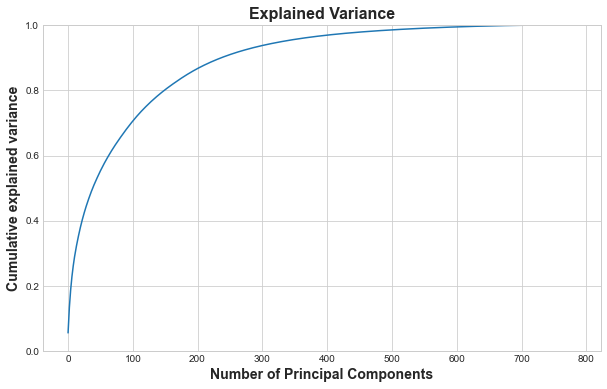

In [30]:
fig = plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(explained_variance))
plt.ylim([0,1.0])

plt.xlabel('Number of Principal Components', fontdict = font_label)
plt.ylabel('Cumulative explained variance', fontdict = font_label)
plt.title('Explained Variance', fontdict = font_title)

plt.show()

This graph signifies how much of the total variance in the data is explained by each additional principal component. <br>
The x-axis represents the number of principal components included in the analysis, while the y-axis represents the cumulative proportion of variation explained by these components.<br> <b> As more principal components are included, the cumulative explained variance increases, indicating that the additional components capture more of the remaining variation in the data. The graph can be used to determine how many principal components are needed to explain a desired proportion of the total variation in the data. </b>

#### Transformation into New-Dimension Space (on New-Basis)

In [31]:
# PCA Components
n_components = 784

transformed_Y = np.dot(eigenvectors[:n_components], scaled_X_train.T)
Y_cov = np.cov(transformed_Y) #be careful with this line, if scaled_Y.T is supplied than covariance for 60000 x 60000 will be calcualted and you machine will go under seizure

In [32]:
scaler_Y = StandardScaler()
new_scaled_Y = scaler_Y.fit_transform(transformed_Y.T)
Y_cov = np.cov(new_scaled_Y.T)

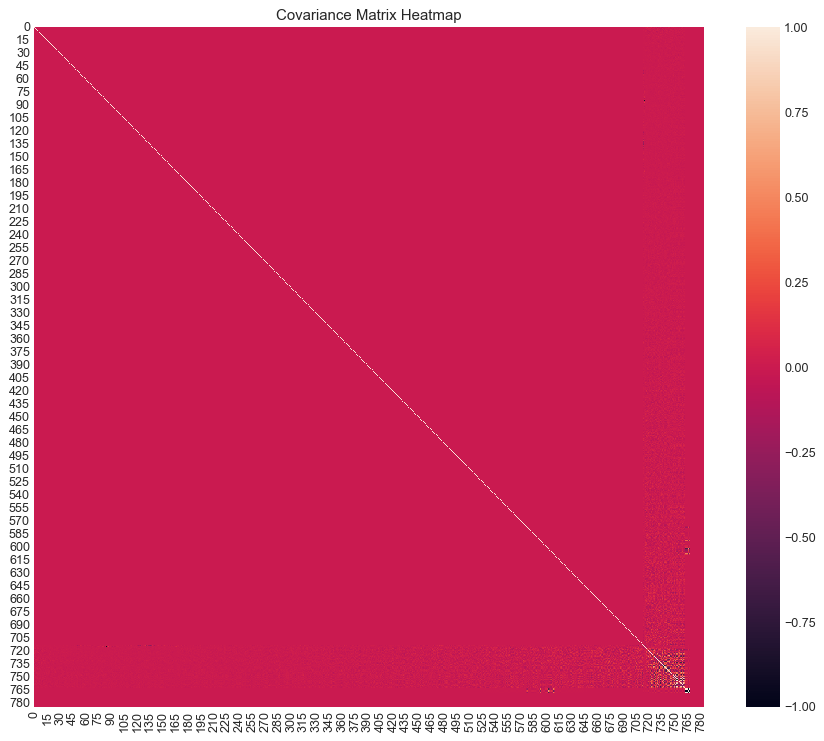

In [33]:
plt.figure(figsize=(12, 10), dpi = 90)
sns.heatmap(Y_cov, annot=False)
plt.tick_params(axis='both', which='both', labelsize=10)
plt.title("Covariance Matrix Heatmap")
plt.show()

#### Analysis:
1. A bright line exists along the principal diagonal but isn't visible due to the massive graph size. 
2. This truly demonstratest that the transformation of eigenvector basis has been able to reduce noise and can be applied to reduce the dimension of the data. i.e. High Variance along principal diagonal.
3. Also, lowest (nearly 0) value else where in the plot could signify that the covariance is nearly zero which means that the correlation between attribtues is low as possible and thus the redundancy is removed.
4. In a typical scenario, the covariance matrix of the transformed Y in PCA analysis should have the highest value along the principal diagonal. The principal components are constructed in a way that the first component captures the maximum variance in the data, the second component captures the next highest variance orthogonal to the first component, and so on. But, in this case, the heatmap of the covariance matrix of the transformed Y doesn't exhibit maximum value along the principal diagonal from (765, 765), this is actually due to clipping effect in the eigenvalues. <br>
NOTE: The covariance matrix can be influenced by factors such as data scaling and preprocessing

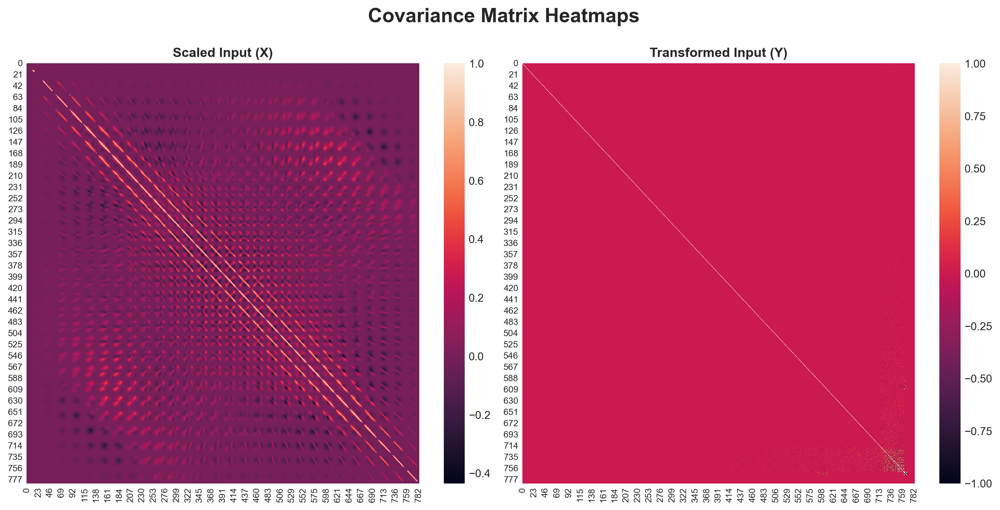

In [34]:
fig, axes = plt.subplots(1, 2, figsize = (16, 7), dpi =240)
fig.suptitle('Covariance Matrix Heatmaps', fontsize = 18, fontweight = 'bold')
fig.subplots_adjust(wspace = 0.01)

sns.heatmap(X_cov, annot = False, ax = axes[0])
axes[0].set_title('Scaled Input (X)', fontdict = {'size':12, 'weight':'bold'})
axes[0].tick_params(axis = 'both', labelsize = 8)

sns.heatmap(Y_cov, annot = False, ax = axes[1])
axes[1].set_title('Transformed Input (Y)', fontdict = {'size':12, 'weight':'bold'})
axes[1].tick_params(axis = 'both', labelsize = 8)
plt.show()

#### Analysis
1. This comparison of covariance matrix heatmaps between the Scaled Input (X) and the Transformed Input (Y) clearly shows that after PCA, the variance of the elements is increased, indicating that more important information is now visible. Additionally, the correlation between dimensions, i.e., the covariance, is minimized as much as possible.

In [35]:
def PCA_m(n_com):
    transformed_Y = np.dot(eigenvectors[:n_com], scaled_X_train.T)
    return transformed_Y.T

In [36]:
def get_n_principal_components(n):
    return eigenvectors[:n]

#### Visualizing the Principle Components

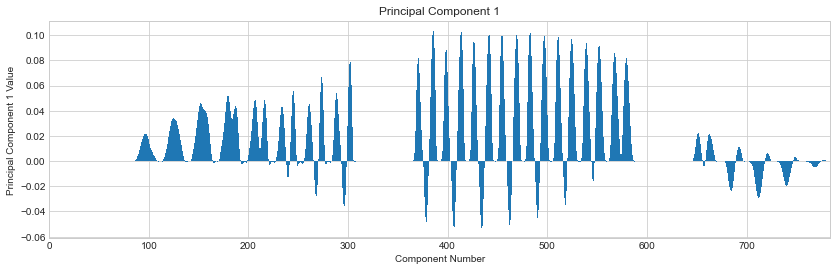

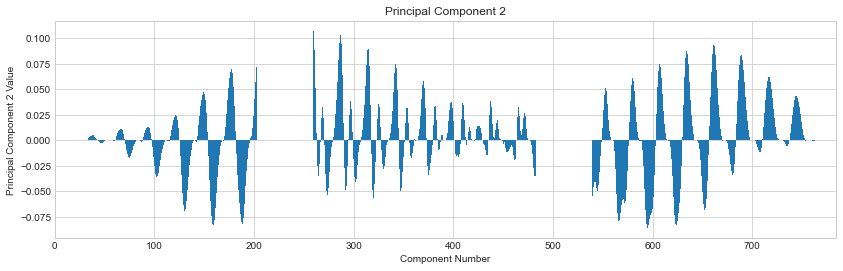

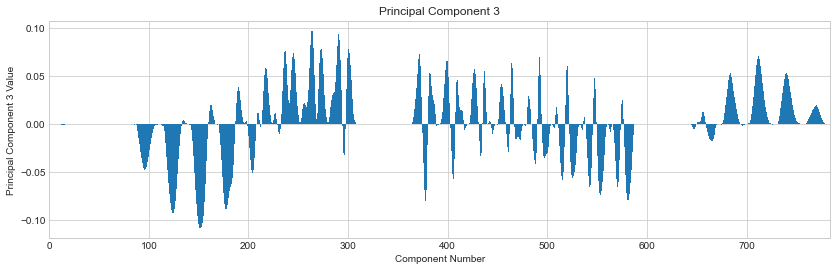

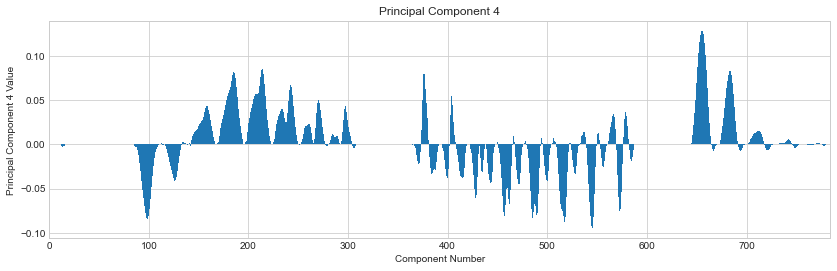

In [37]:
first_four_components = get_n_principal_components(4)
for i in range(4):
    fig = plt.figure(figsize = (14, 4))
    plt.bar(range(len(first_four_components[i])), first_four_components[i])
    plt.xlabel('Component Number')
    plt.ylabel('Principal Component '+str(i+1)+' Value')
    plt.title('Principal Component '+str(i+1))
    plt.xlim(0, 784)
    plt.show()

#### Analysis:
1. This barplot of first four prominent principal components shows what eigenvector components is important.
2. If this 784 dimension principal components is reshaped to (28, 28) image, then a pattern can be seen whose description would be that the pixels where there is absence of intensity, the corresponding principal component value is 0 and for the presence of any digit pixel, the corresponding value is high.
3. Likewise, each principal components shows on which part of the pixel (28 x 28 => 784), does that principal component give emphasis to.

#### Lets compare the Principal Components with Sklearn PCA

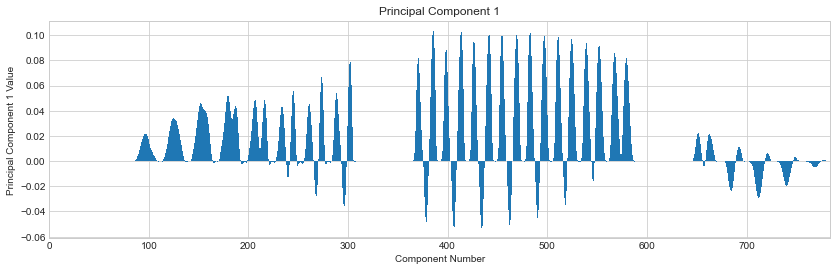

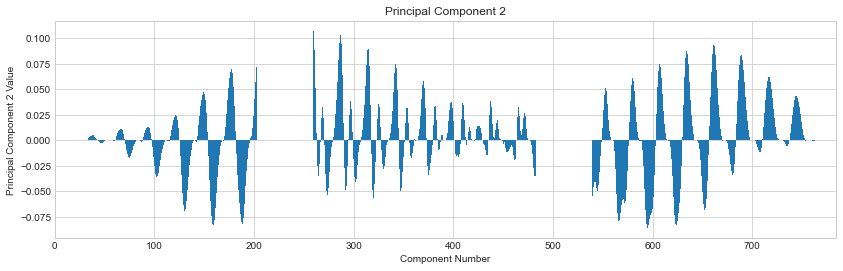

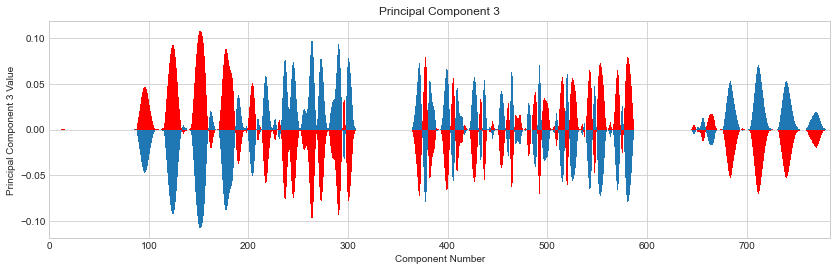

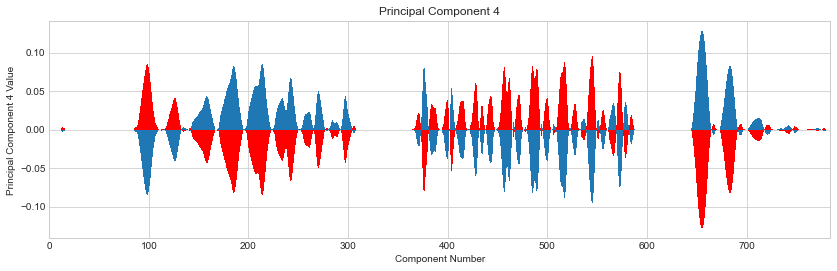

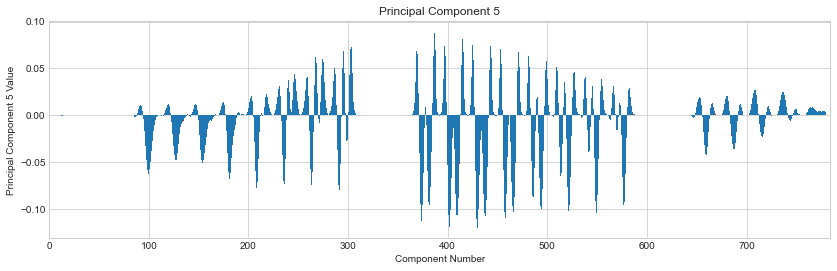

In [39]:
sklearn_pca = PCA(n_components = 5).fit(scaled_X_train)
first_five_components = get_n_principal_components(5)

for i in range(5):
    fig = plt.figure(figsize = (14, 4))
    plt.bar(range(len(sklearn_pca.components_[i])), sklearn_pca.components_[i], color = 'red')
    plt.bar(range(len(first_five_components[i])), first_five_components[i])
    plt.xlabel('Component Number')
    plt.ylabel('Principal Component '+str(i+1)+' Value')
    plt.title('Principal Component '+str(i+1))
    plt.xlim(0, 784)
    plt.show()

#### Analysis:
1. This is an overlap of barplot of the corresponding top 5 principal components from our generated and the one generated by the PCA module from skleran.
2. The 'red' element is from the PCA module and the 'blue' element is our implemented PCA model.
3. For PC1, PC2 and PC5, we can see that there is near to perfect overlap between the corresponding PC values for that particular components.
4. But, for PC3 and PC4, we can see that the bar plot of both are inverted to each other. This might be due to the fact that each principal component is perpendicular to the previous component, and since there is 2 possible perpendiculars to a given plane (to say) so what could have happened is that on PC3 and PC4 the perpendiculars are just opposite resulting is opposite direction but equal magnitudes. 

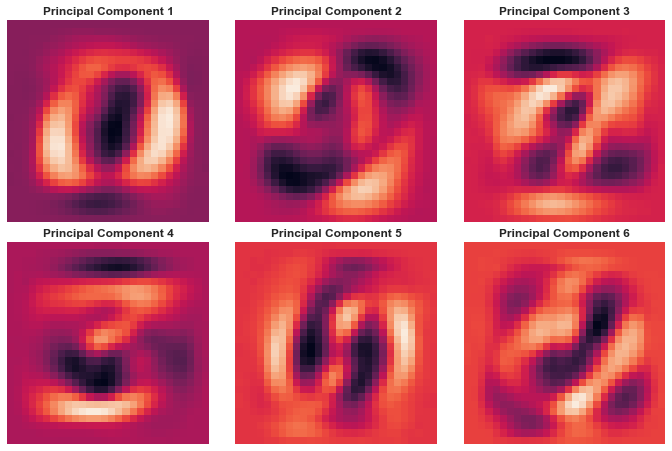

In [64]:
fig = plt.figure(figsize=(12, 6))
plt.subplots_adjust(left=0.01, right=0.80, bottom=0.01, top=0.99, wspace=0.01, hspace=0.1)
axes = [fig.add_subplot(230 + i + 1) for i in range(6)]

first_six_components = get_n_principal_components(6)

for i, ax in enumerate(axes):
    sns.heatmap(first_six_components[i].reshape(28, 28), 
                square=True, ax=ax, cbar = False)
    ax.set_title('Principal Component '+ str(i + 1), fontdict = {'size':12, 'weight':'bold'})
    ax.axis('off')
plt.show()

#### Analysis:
1. Here is the heatmap plot of first six principal components. 
2. This plot is a better visualization in compared to the bar plot shown above.
3. This validates our above analysis that the pixels with bright intensity is the region where that particular principal component is giving more emphasis and the pixels to dark intensity. 
4. Also different principal components given emphasis to differnt sturcture of the input digit data. 

#### Explained variance

In [79]:
explained_variance_df = pd.DataFrame(([(j, np.cumsum(explained_variance)[j]) for j in range(len(explained_variance))]), columns = ['Principal Components', 'Variance Retained'])
explained_variance_df.head(2)

,Principal Components,Variance Retained
0,0,0.056427
1,1,0.096839


This shows how much of the variance will be explained if we select first N principal components.
- 5 PC will explain 20% of the variance.
- 20 PC will explain 38% of the variance.
- 98 PC will explain 70% of the variance.
- 149 PC will explain 80% of the variance.
- 237 PC will explain 90% of the variance.

### Projection into Feature Subspace

In [88]:
# Lets work with 5-PC components for now:
Y = PCA_m(5)

In [82]:
# To color each point by the digit it represents,
# create a color map with 10 elements (10 RGB values).
# Then, use the system response (y_training), which conveniently
# is a digit from 0 to 9.
def get_cmap(n):
    #colorz = plt.cm.cool
    colorz = plt.get_cmap('Set1')
    return [ colorz(float(i)/n) for i in range(n)]

colorz = get_cmap(10)
colors = [colorz[yy] for yy in y_train_target]

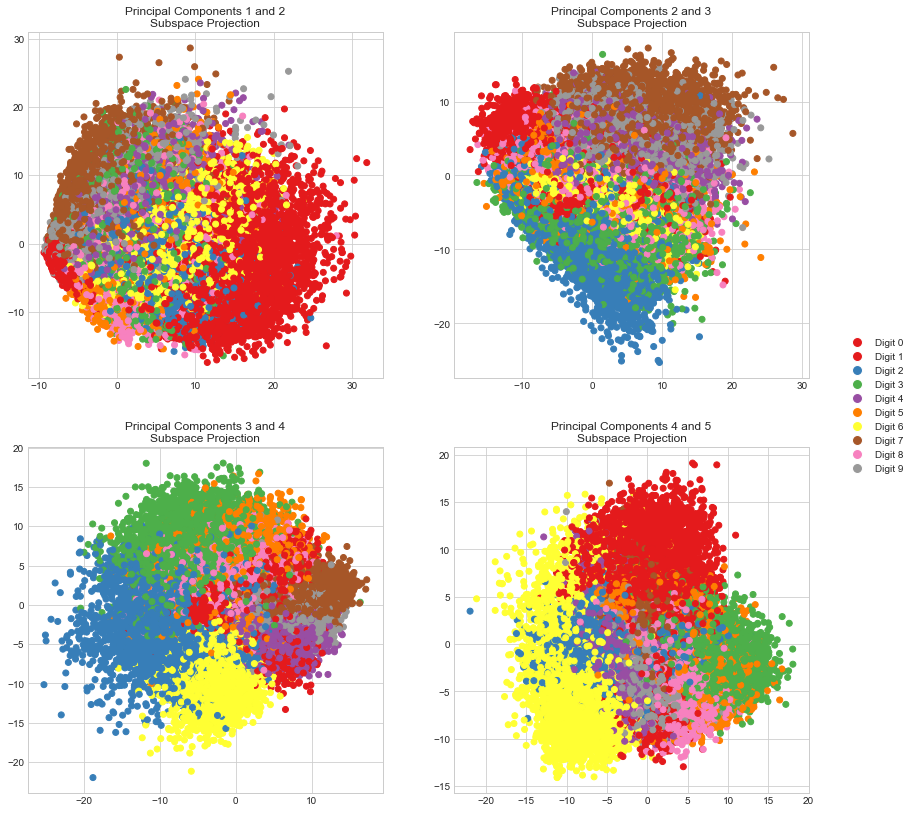

Explained Variance, Principal Component 1: 29.96%
Explained Variance, Principal Component 2: 21.45%
Explained Variance, Principal Component 3: 19.85%
Explained Variance, Principal Component 4: 15.36%
Explained Variance, Principal Component 5: 13.38%


In [107]:
fig = plt.figure(figsize=(14,14))
axes = [fig.add_subplot(220 + i + 1) for i in range(4)]

axes[0].scatter( Y[:,0], Y[:,1] , c = colors)
axes[0].set_title('Principal Components 1 and 2\nSubspace Projection')

axes[1].scatter( Y[:,1], Y[:,2] , c = colors )
axes[1].set_title('Principal Components 2 and 3\nSubspace Projection')

axes[2].scatter( Y[:,2], Y[:,3] , c = colors )
axes[2].set_title('Principal Components 3 and 4\nSubspace Projection')

axes[3].scatter( Y[:,3], Y[:,4] , c = colors )
axes[3].set_title('Principal Components 4 and 5\nSubspace Projection')

# Create a custom legend
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label='Digit ' + str(i),
                              markerfacecolor=colorz[i], markersize=10) for i in range(10)]
legend = fig.legend(handles = legend_elements, loc='center right')
fig.canvas.draw()

plt.show()

n_components = 5
total_variance = np.sum(explained_variance[0:n_components])
for i in range(n_components):
    print("Explained Variance, Principal Component %d: %0.2f%%"%(i + 1, explained_variance[i] * 100/total_variance))

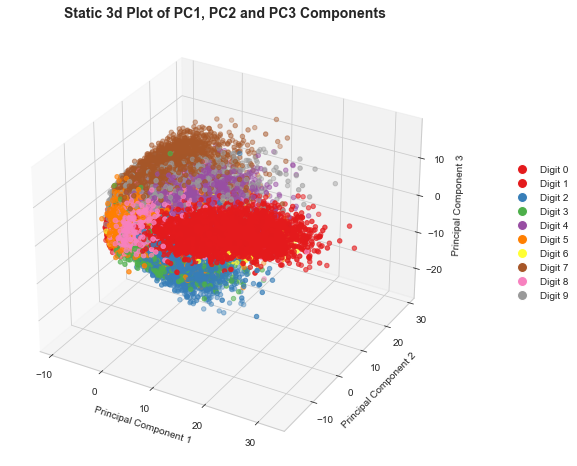

In [118]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(Y[:, 0], Y[:, 1], Y[:, 2], c=colors)
ax.set_xlabel('Principal Component 1')
ax.set_ylabel('Principal Component 2')
ax.set_zlabel('Principal Component 3')

# Create a custom legend
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label='Digit ' + str(i),
                              markerfacecolor=colorz[i], markersize=10) for i in range(10)]
legend = fig.legend(handles=legend_elements, loc='center right')
fig.canvas.draw()
plt.title('Static 3d Plot of PC1, PC2 and PC3 Components', fontdict = {'size': 14, 'weight': 'bold'})

plt.show()

In [128]:
import plotly.graph_objects as go

# Map colors to digits
digit_colors = [colorz[i] for i in y_train_target]

fig = go.Figure()

# Add main scatter plot
fig.add_trace(go.Scatter3d(
    x=Y[:, 0],
    y=Y[:, 1],
    z=Y[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color = digit_colors,
        opacity = 0.8
    ),
    showlegend=False
))

# Add legend items
for i in range(10):
    fig.add_trace(go.Scatter3d(
        x=[None],
        y=[None],
        z=[None],
        mode='markers',
        marker=dict(
            size = 20,
            color = colorz[i],
            opacity = 1.0
        ),
        name = str(i)
    ))

fig.update_layout(
    title='Interactive 3D Scatter Plot of PC1, PC2 and PC3 Components',
    scene=dict(
        xaxis=dict(title='Principal Component 1'),
        yaxis=dict(title='Principal Component 2'),
        zaxis=dict(title='Principal Component 3')
    ),
    showlegend=True
)

fig.show()

#### Analysis: (UJJWAL MAKE AMENDS)
1. 

In [130]:
pairplot_df = pd.DataFrame(Y, columns=['Principal Component '+str(j) for j in range(Y.shape[1])])
pairplot_df.reindex(pairplot_df.columns.sort_values(ascending=True))
z_columns = pairplot_df.columns

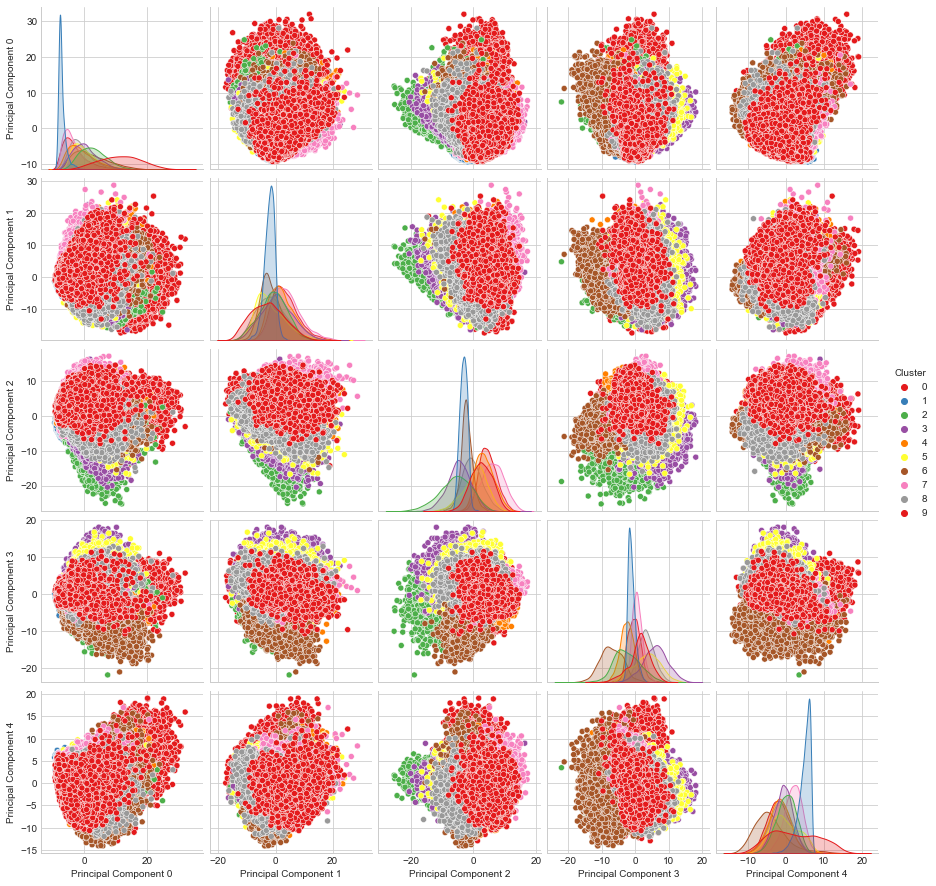

In [132]:
pairplot_df['Cluster'] = y_train_target
pairplot_df = pairplot_df.sort_values('Cluster',ascending=True)
sns.pairplot(pairplot_df, hue='Cluster', 
             vars=z_columns, # don't plot the category/system response
             palette='Set1')
plt.show()

#### Analysis:
1. UJJWAL WRITE SOME HUTITAU SUTFF.<br>
<br>
How do we interpret this plot?

First, it's a pleasant surprises that even with a measly four principal components, the various points corresponding to various digits still cluster nicely - in some data sets, this is not so clear. The location of these points will compose a probability density function, which could be combined with probabilistic methods to produce a prediction of what digit a point comes from based on where it is located.

The unfortunate thing about the plot is that the clusters are sitting on top of one another. More principal components, or other clustering techniques, can further differentiate these points, but with only four principal components, the explained variance is not high enough to segregate the clusters further.

### Reconstrunction Error and Back-Projection

In [173]:
# First Five Components
transformation_matrix = get_n_principal_components(121)
print("Transformation Matrix Shape: ", transformation_matrix.shape)
X_digit_1 = X_train_input.iloc[0]
print("Before Transformation (Shape): ", X_digit_1.shape)
Y_digit_1 = np.dot(transformation_matrix, X_digit_1.T)
print("After Transformation (Shape): ", Y_digit_1.shape)
Xhat_digit_1 = np.dot(transformation_matrix.T, Y_digit_1)
print("Back-Projected Shape: ", Xhat_digit_1.shape)

Transformation Matrix Shape:  (121, 784)
Before Transformation (Shape):  (784,)
After Transformation (Shape):  (121,)
Back-Projected Shape:  (784,)


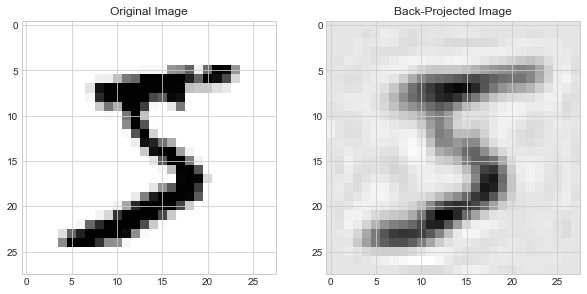

In [174]:
fig = plt.figure(figsize=(10,6))
ax1, ax2 = (fig.add_subplot(121+i) for i in range(2))

ax1.imshow(X_digit_1.to_numpy().reshape(28, 28))
ax1.set_title('Original Image')
ax2.imshow(Xhat_digit_1.reshape(28, 28))
ax2.set_title('Back-Projected Image')

plt.show()

<b> The above two cells needs to be converted into a suitable function such that for a given input for varying components, the back-projected images should be given as output </b>

# TILL THIS POINT 
### GARBAGE BELOW

### Logistic Regression

In [ ]:
def run_exp(no_components):
    scaled_Y = eigenvectors[:no_components] @ scaled_X_train.T
    Y = scaled_Y.T
    new_df = pd.DataFrame(Y)
    new_df['label'] = y_train_target
    y = new_df['label']
    X = new_df.drop('label', axis = 1)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 69)
    lr_classifier = LogisticRegression(random_state = 69, max_iter = 1000)
    lr_classifier.fit(X_train, y_train)
    y_pred = lr_classifier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred) * 100
    print(f"{no_components} Components => Accuracy: {accuracy:.2f}%")
    return no_components, accuracy

In [ ]:
exp_data = []
for i in range(1, 50, 2):
    exp_data.append(run_exp(i))

In [ ]:
compressed_output = Y[0].reshape(28, 28)

plt.imshow(compressed_output, cmap = 'gray')
plt.title(f'Target Label: {y_train_target[0]}')
plt.axis('off')
plt.show()

### Try out Different Components of PCA

#### Four-Component PCA : Building a PCA Model with 4 Prominent or Principal Components

In [ ]:
sklearn_pca = PCA(n_components = 10).fit(scaled_X_train)
print(sklearn_pca.components_.shape)

In [ ]:
colors = ['dusty purple','dusty green','dusty blue','orange']

plt.show()
for i in range(4):
    fig = plt.figure(figsize=(14,4))
#     sns.barplot(range(len(sklearn_pca.components_[i])), sklearn_pca.components_[i], color=colors[i])
    plt.bar(range(len(sklearn_pca.components_[i])), sklearn_pca.components_[i])
    plt.xlabel('Component Number')
    plt.ylabel('Principal Component '+str(i+1)+' Value')
    plt.title('Principal Component '+str(i+1))
    plt.show()

In [ ]:
fig = plt.figure(figsize=(12,10))
axes = [fig.add_subplot(220+i+1) for i in range(4)]

for i,ax in enumerate(axes):
    sns.heatmap(sklearn_pca.components_[i].reshape(28,28), 
                square=True, ax=ax, 
                vmax = 0.30, vmin=-0.30, cmap = 'coolwarm')
    ax.set_title('Principal Component '+str(i))
    #ax.set_xlabel('Horz Pixels')
    #ax.set_ylabel('Vert Pixels')
    
plt.show()

In [ ]:
print(np.cumsum(explained_variance)[121])

In [ ]:
pprint([(j, np.cumsum(explained_variance)[j]) for j in range(len(explained_variance[:122]))])

#### Projection into Feature Subspace

In [ ]:
matW = np.hstack(pair[1].reshape(784,1) for pair in eigen_values_vectors[0:121] )
print(matW.shape)

In [ ]:
Z = np.dot(scaled_X_train, matW) 

In [ ]:
Z.shape

In [ ]:
def get_cmap(n):
    #colorz = plt.cm.cool
    colorz = plt.get_cmap('Set1')
    return [ colorz(float(i)/n) for i in range(n)]

colorz = get_cmap(10)
colors = [colorz[yy] for yy in y_train_target]

In [ ]:
fig = plt.figure(figsize=(14,6))
ax1, ax2 = [fig.add_subplot(120 + i + 1) for i in range(2)]

ax1.scatter( Z[:,0], Z[:,1] , c=colors )
ax1.set_title('Principal Components 1 and 2\nSubspace Projection')

ax2.scatter( Z[:,2], Z[:,3] , c=colors )
ax2.set_title('Principal Components 3 and 4\nSubspace Projection')

plt.legend()
plt.show()

n_components = 4
total_variance = np.sum(explained_variance[0:n_components])
for i in range(n_components):
    print("Explained Variance, Principal Component %d: %0.4f"%(i,explained_variance[i]/total_variance))

In [ ]:
pairplot_df = pd.DataFrame(Z, columns=['Principal Component '+str(j) for j in range(Z.shape[1])])
pairplot_df.reindex(pairplot_df.columns.sort_values(ascending=True))
z_columns = pairplot_df.columns

In [ ]:
# pairplot_df['Cluster'] = y_train_target
# pairplot_df = pairplot_df.sort_values('Cluster',ascending=True)
# sns.pairplot(pairplot_df, hue='Cluster', 
#              vars=z_columns, # don't plot the category/system response
#              palette='Set1')
# plt.show()

### Assessing a PCA Model: Reconstruction Error and Back-Projection

In [ ]:
matW = np.hstack(pair[1].reshape(784,1) for pair in eigen_values_vectors[0:5] )
X_digit1 = scaled_X_train[5]
Z_digit1 = X_digit1.dot(matW)
Xhat_digit1 = Z_digit1.dot(matW.T)

fig = plt.figure(figsize=(10,6))
ax1, ax2, ax3, ax4 = (fig.add_subplot(221+i) for i in range(4))


ax1.imshow(X_digit1.reshape(28,28), cmap = 'gray')
ax1.set_title('Original Image')

ax2.imshow(Xhat_digit1.reshape(28,28))
ax2.set_title('Back-Projected Image')


ax3.imshow(X_digit1.reshape(28, 28),
             interpolation = "none")
ax3.set_title('Original Image (No Interp)')


ax4.imshow(Xhat_digit1.reshape(28, 28),
             interpolation = "none")
ax4.set_title('Back-Projected Image (No Interp)')

plt.grid('off')
plt.show()

In [ ]:
for j in range(5):
    X_digit = scaled_X_train[j+20]
    Z_digit = X_digit.dot(matW)
    Xhat_digit = Z_digit.dot(matW.T)

    fig = plt.figure(figsize=(6,4))
    plt.style.use("default")
    ax1, ax2 = (fig.add_subplot(121+i) for i in range(2))

    print(X_train_input.iloc[j, :].shape)
    exit()
    ax1.imshow(X_train_input.iloc[:, :].reshape(28, 28),
              cmap = "gray")
    ax1.set_title('Original Image')

    ax2.imshow(Xhat_digit.reshape(28, 28), 
              cmap = "gray")
    ax2.set_title('Back-Projected Image')
    ax1.grid(False)
    ax2.grid(False)
    ax1.axis('off')
    ax2.axis('off')

plt.show()

In [ ]:
X_digit1 = scaled_X_train[0]
Z_digit1 = X_digit1.dot(matW)
Xhat_digit1 = Z_digit1.dot(matW.T)

mse = ((Xhat_digit1 - X_digit1)**2).mean(axis=None)
print(mse)

In [ ]:
X_hat = sklearn_pca.inverse_transform( sklearn_pca.transform(scaled_X_train) )

mse = ((X_hat - scaled_X_train)**2).mean(axis=None)
print(mse)
print(1-mse)


In [ ]:
print(np.cumsum(explained_variance)[:4])

In [ ]:
def pca_mse(n):
    # Make PCA
    pca = PCA(n_components=n, whiten=True)
    pca.fit(scaled_X_train)
    X_red = pca.transform(scaled_X_train)

    # MSE associated with back-projection:
    X_orig = scaled_X_train
    X_hat = pca.inverse_transform( pca.transform(X_orig) )
    mse = ((X_hat - X_orig)**2).mean(axis=None)
    
    return mse

In [ ]:
mses = []
N = 33
for i in range(1,N):
    m = pca_mse(i)
    pprint("%d-component PCA: MSE = %0.4g"%(i,m))
    mses.append((i,m))
mses = np.array(mses)

In [ ]:
plt.plot(mses[:,0],mses[:,1],'-o',label='MSE')
plt.plot(mses[:,0],1.0-mses[:,1],'-o',label='Rsq')

plt.title('Mean Square Error, Principal Components Analysis')
plt.xlabel('Number of Principal Components')
plt.ylabel('Mean Square Error')

plt.show()

In [ ]:
plt.plot(range(1,len(explained_variance)+1),np.cumsum(explained_variance),
         '-o',label='Expl Var')
plt.plot(mses[:,0],1.0-mses[:,1],'-o',label='1-MSE')

plt.title('(1-MSE) versus Explained Variance')
plt.xlabel('Number of Principal Components')
plt.ylabel('Mean Square Error/Explained Variance')
plt.legend(loc='best')
plt.show()